<a href="https://colab.research.google.com/github/terka-creator/Linkedin-data-job-offers/blob/main/Rental_apartments_in_Krakow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction: Rental apartments in Krakow

In [15]:
# @title Data Loading and Preprocessing
#loading libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


#loadind rental data from github
allcsv = {
  '2023-11-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2023_11.csv'),
  '2023-12-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2023_12.csv'),
  '2024-01-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2024_01.csv'),
  '2024-02-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2024_02.csv'),
  '2024-03-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2024_03.csv'),
  '2024-04-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2024_04.csv'),
  '2024-05-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2024_05.csv'),
  '2024-06-01': pd.read_csv('https://raw.githubusercontent.com/terka-creator/rental-apartments-in-Krakow/refs/heads/main/apartments_rent_pl_2024_06.csv'),
}

#concating data into one DataFrame
dfs = []
for date in allcsv:
  allcsv[date]['date'] = date
  dfs.append(allcsv[date])

allcsv = pd.concat(dfs)
allcsv['date'] = pd.to_datetime(allcsv['date'])

#filtering for krakow data only
df = allcsv[allcsv['city'] == 'krakow'].copy()
df.drop(columns=['id', 'city'], inplace=True)

#reseting index for future plotting
df = df.reset_index(drop=True)

**Project overview**

Welcome to rental apartments analysis performed for Kraków from from November 2023 to June 2024.

I aim to get insights about the rental market conditions in one of the largest cities in Poland. I focus on:

*   price factors
*   anomalies in room count based on apartment size
*   influence of distance to the city center on apartment prices


**Data source**

The data comes from Kaggle and includes information about rental and for-sale apartments from several cities in Poland. You can find more details at this link: [Apartment Prices in Poland](https://www.kaggle.com/datasets/krzysztofjamroz/apartment-prices-in-poland/data).


---

Let's see all records on interactive map of Krakow.


In [16]:
# adding an interactive map
import folium as folium

m = folium.Map(location=[50.0647, 19.9450], zoom_start=12)


# Adding points to the map
for index, row in df.iterrows():
    color = sns.color_palette("flare", as_cmap=True)(row['price'] / df['price'].max())
    hex_color = "#{:02x}{:02x}{:02x}".format(int(color[0]*255), int(color[1]*255), int(color[2]*255))

    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        popup=f"Price: {row['price']}, Size: {row['squareMeters']}, Rooms: {row['rooms']}",
        color=hex_color,
        fill=True,
        fill_color=hex_color,
        fill_opacity=0.7,
    ).add_to(m)

m

# Chapter 1: Data exploration

With over 12,000 records, it's challenging to manually identify clear trends in the data. Additionally, people often refer to general size of the apartment rather than its exact area in square meters. For better analysis, I will group apartments into five size categories, which I will use in subsequent plot:

Micro apartment: up to 35 m²

Small apartment: 36–45 m²

Medium apartment: 46–65 m²

Large apartment: 66–90 m²

Extra-large apartment: 91 m² and above

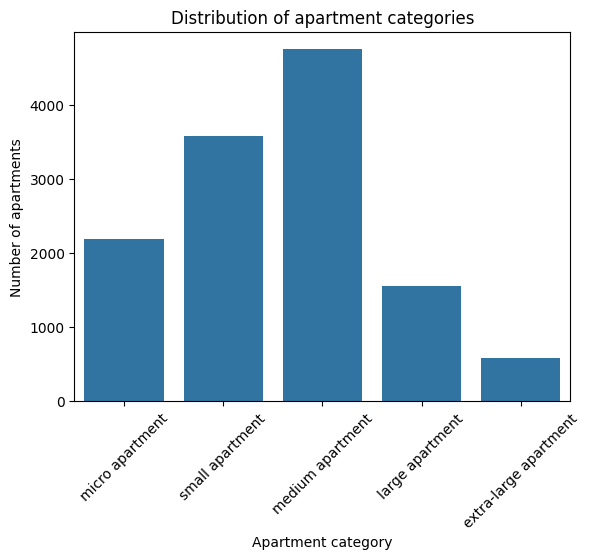

In [17]:
#setting labels and bins for squareMeters grouping
labels = ['micro apartment','small apartment','medium apartment', 'large apartment','extra-large apartment']
min_val=df['squareMeters'].min()
max_val=df['squareMeters'].max()
bins = [min_val-1, 35, 45, 65, 90, max_val+1]
df['apartmentCategory'] = pd.cut(df['squareMeters'], labels=labels, bins=bins)

#distribution of apartments by category
sns.countplot(x='apartmentCategory',data=df)
plt.xticks(rotation=45)
plt.title('Distribution of apartment categories')
plt.xlabel('Apartment category')
plt.ylabel('Number of apartments')
plt.show()

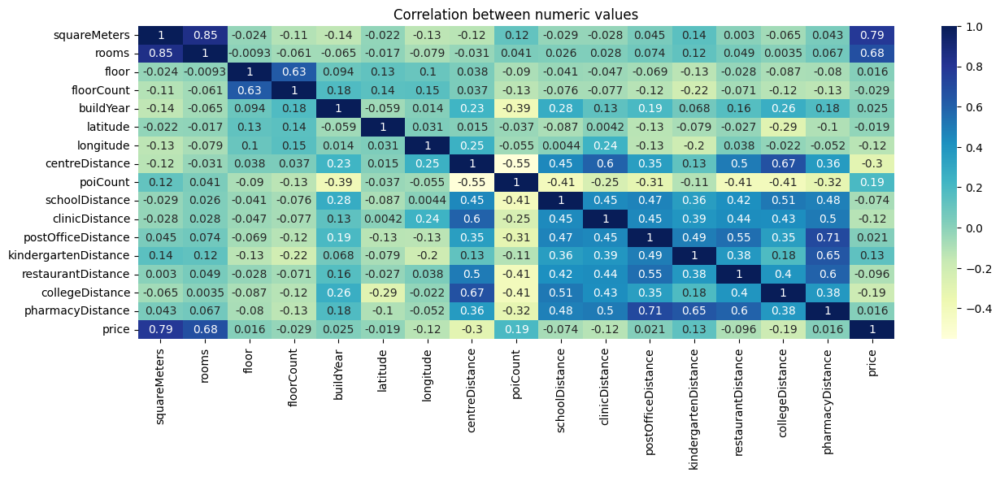

In [18]:
#showing correlation between numerical columns
plt.figure(figsize=(15,5))
sns.heatmap(df.corr(numeric_only=True), cmap='YlGnBu', annot=True)
plt.title('Correlation between numeric values')
plt.show()

/tmp/ipython-input-2864249030.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  offersByMonth = df.groupby(['month_year', 'apartmentCategory']).size().unstack(fill_value=0)


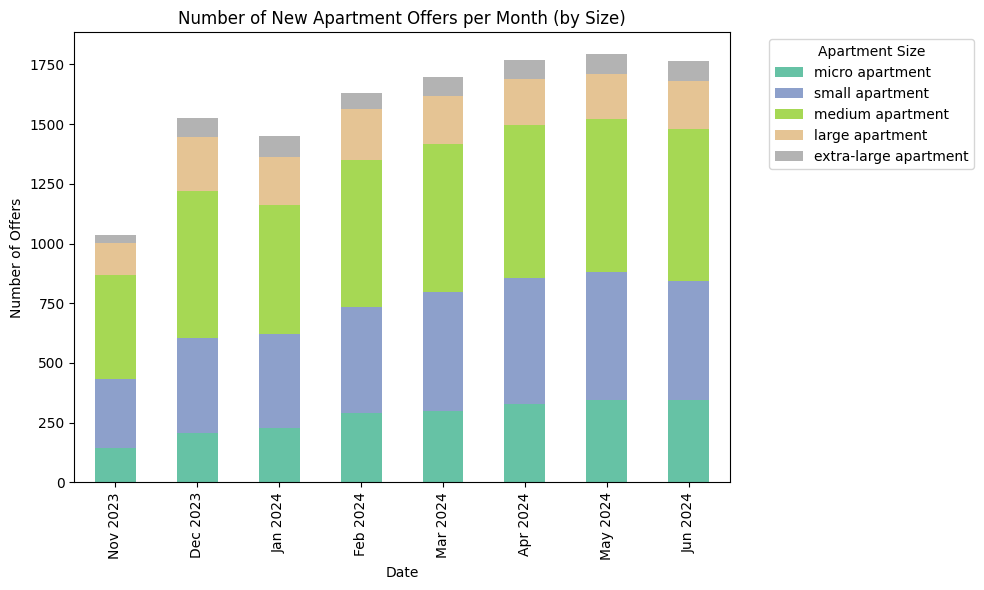

In [19]:
#number of new offers every month

#adding column with formatting "Mth Year"
df['month_year'] = df['date'].dt.strftime('%b %Y')

offersByMonth = df.groupby(['month_year', 'apartmentCategory']).size().unstack(fill_value=0)
month_order=['Nov 2023', 'Dec 2023', 'Jan 2024', 'Feb 2024', 'Mar 2024', 'Apr 2024', 'May 2024', 'Jun 2024']
ax=offersByMonth.loc[month_order].plot(kind='bar',stacked=True, figsize=(10, 6),colormap='Set2')
plt.title('Number of New Apartment Offers per Month (by Size)')
plt.xlabel('Date')
plt.ylabel('Number of Offers')
plt.xticks(rotation=90)
plt.legend(title='Apartment Size', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

I'll verify the dataset's completeness. From the correlation plot, we can see which columns contain key data for this analysis. Ideally, missing values should be **under 5%**. For important columns, up to 10% missing data is acceptable. Columns with more than 50% missing values won’t be used.

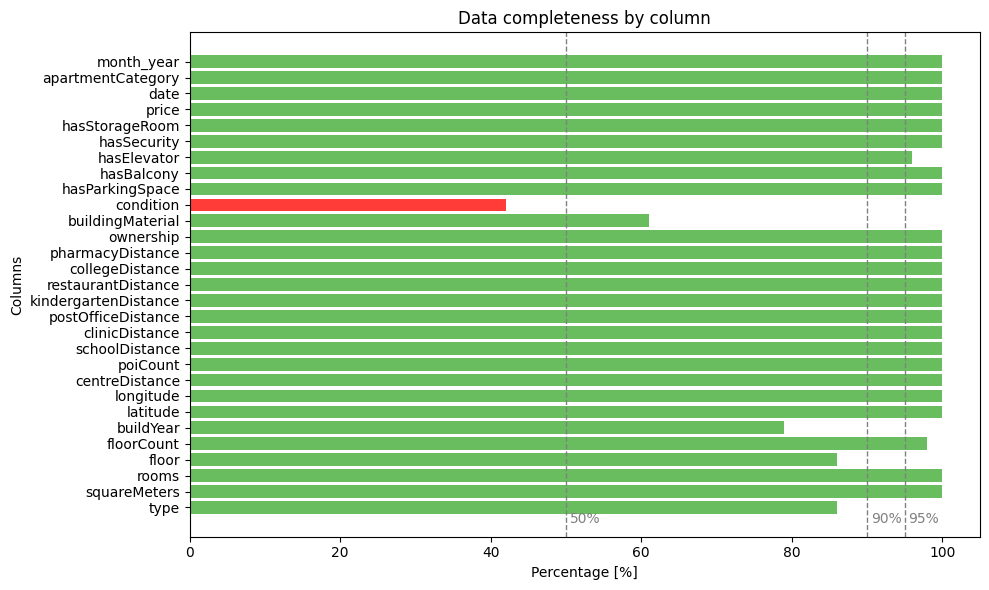

In [20]:
#displaying percentage of data completeness
per = []
barCol = []

for col in df.columns:
  p = ((1-df[col].isnull().sum()/len(df))*100).round()
  per.append(p)
  if p >= 51.0:
    barCol.append('#69BD5F')
  elif p < 50.0:
    barCol.append('#FF3C38')

plt.figure(figsize=(10, 6))
plt.barh(df.columns, per, color=barCol)
for pct in [50, 90, 95]:
    plt.axvline(x=pct, color='gray', linestyle='--', linewidth=1)
    plt.text(pct + 0.5, -1, f'{pct}%', color='gray')
plt.title('Data completeness by column')
plt.xlabel('Percentage [%]')
plt.ylabel('Columns')
plt.tight_layout()
plt.show()

# Chapter 2: Price factors




Apartments with more rooms tend to have higher rent prices. However, there are some outliers among 1-, 2-, 3-, and 4-room apartments. This suggests that price is also influenced by other factors that aren't visible in the box plot—such as the total size of the apartment, room sizes, condition of the property, or location.

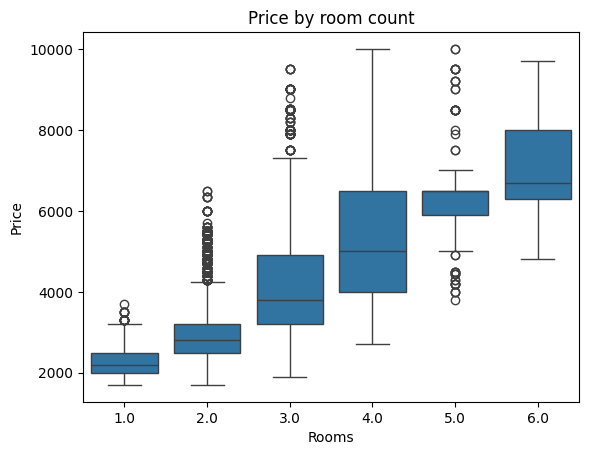

In [21]:
#distribution of prices depending on number of rooms in apartment
sns.boxplot(x='rooms', y='price', data=df)
plt.title('Price by room count')
plt.xlabel('Rooms')
plt.ylabel('Price')
plt.show()

I calculated the price per square meter for each apartment to allow more in-depth comparisons between properties of different sizes.

The boxplots illustrate the distribution of values for both total price and price per square meter. It is evident that our dataset contains a significant number of outliers, particularly on the higher end of the distribution. These outliers may represent atypical properties, such as luxury listings or data entry errors, and could potentially skew statistical analyses if not properly addressed.

The scatter plot helps identify trends, such as smaller apartments often being more expensive per square meter, and also highlights outliers that may point to other influential factors like location or apartment quality.

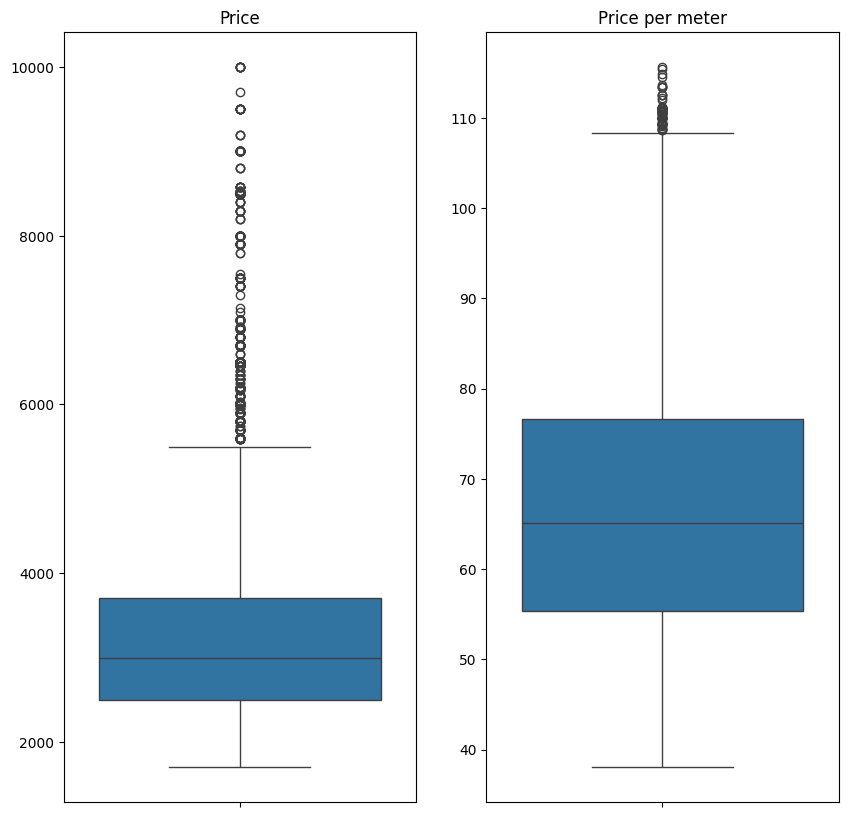

In [22]:
#calculating price per square meter in each apartment - this helps to compare apartments of different sizes more fairly and identify patterns or outliers in pricing
df['pricePerMeter'] = df['price']/df['squareMeters']

#boxplot of price and price per meter
plt.figure(figsize=(10, 10))
plt.subplot(1,2,1)
g=sns.boxplot(y='price',data=df)
g.set(ylabel=None)
plt.title('Price')

plt.subplot(1,2,2)
g=sns.boxplot(y='pricePerMeter',data=df)
g.set(ylabel=None)
plt.title('Price per meter')
plt.show()

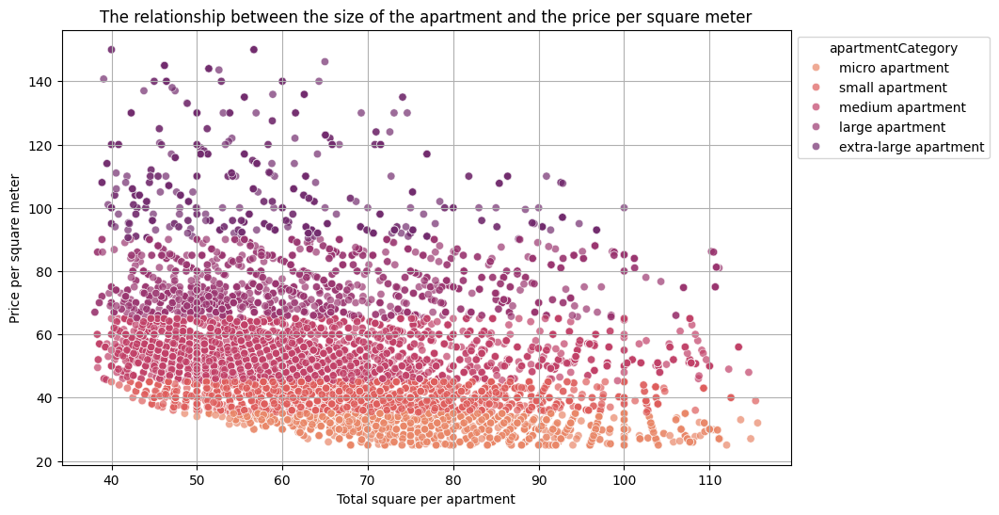

In [23]:
#relationship between price per meter and total size of apartment
plt.figure(figsize=(10, 6))
ax=sns.scatterplot(data=df, y = 'squareMeters', x= 'pricePerMeter', hue='apartmentCategory',palette='flare',alpha=0.7)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.title('The relationship between the size of the apartment and the price per square meter')
plt.xlabel('Total square per apartment')
plt.ylabel('Price per square meter')
plt.grid(True)
plt.show()

/tmp/ipython-input-4275680752.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pricePerMonth = df.groupby(['month_year', 'apartmentCategory'])['price'].mean().unstack(fill_value=0)


<Figure size 1200x700 with 0 Axes>

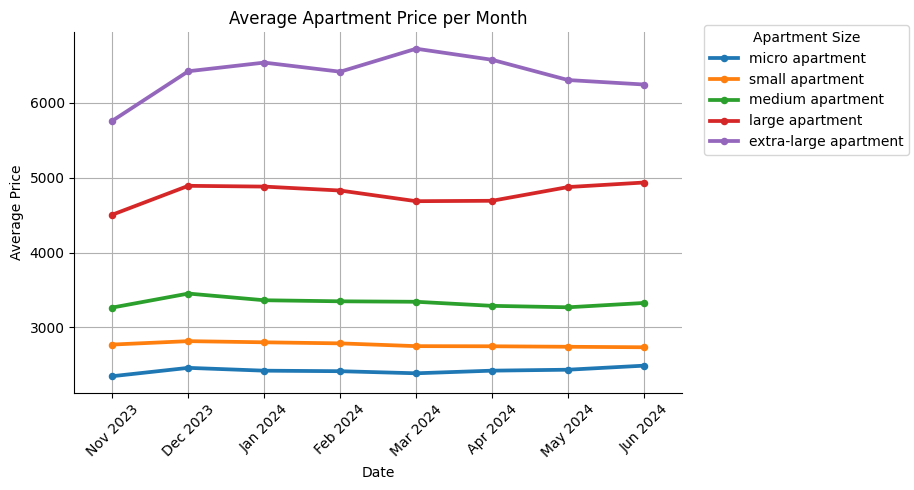

In [24]:
#change of averege prices in time
pricePerMonth = df.groupby(['month_year', 'apartmentCategory'])['price'].mean().unstack(fill_value=0)

# Convert wide format to long format
price_long = pricePerMonth.reset_index().melt(id_vars='month_year', var_name='apartmentCategory',value_name='avgPrice')

#line plot
plt.figure(figsize=(12,7))
g=sns.catplot(data=price_long, kind='point', x='month_year', y='avgPrice', hue='apartmentCategory',order=month_order,markers='.',linestyles='-')
plt.title('Average Apartment Price per Month')
plt.xlabel('Date')
plt.ylabel('Average Price')
plt.xticks(rotation=45)
g._legend.set_title("Apartment Size")
g._legend.set_bbox_to_anchor((1.3, 0.8))
g._legend.set_frame_on(True)
plt.grid(True)
plt.tight_layout()
plt.show()

In [25]:
#checking unique values for categorical data
catCol = ['type', 'ownership', 'buildingMaterial', 'condition', 'hasParkingSpace', 'hasBalcony', 'hasElevator', 'hasStorageRoom', 'hasSecurity']
for col in catCol:
  print(col)
  print(df[col].unique())

type
['apartmentBuilding' 'blockOfFlats' 'tenement' nan]
ownership
['condominium']
buildingMaterial
['brick' nan 'concreteSlab']
condition
[nan 'premium' 'low']
hasParkingSpace
['yes' 'no']
hasBalcony
['yes' 'no']
hasElevator
['yes' 'no' nan]
hasStorageRoom
['no' 'yes']
hasSecurity
['no' 'yes']


**Note:** Many of the categorical values in the dataset are either "yes" or "no." While converting these to binary values (e.g., 1 for "yes" and 0 for "no") can be useful for analyzing correlations with price, this analysis takes a different approach and uses alternative visualizations instead.

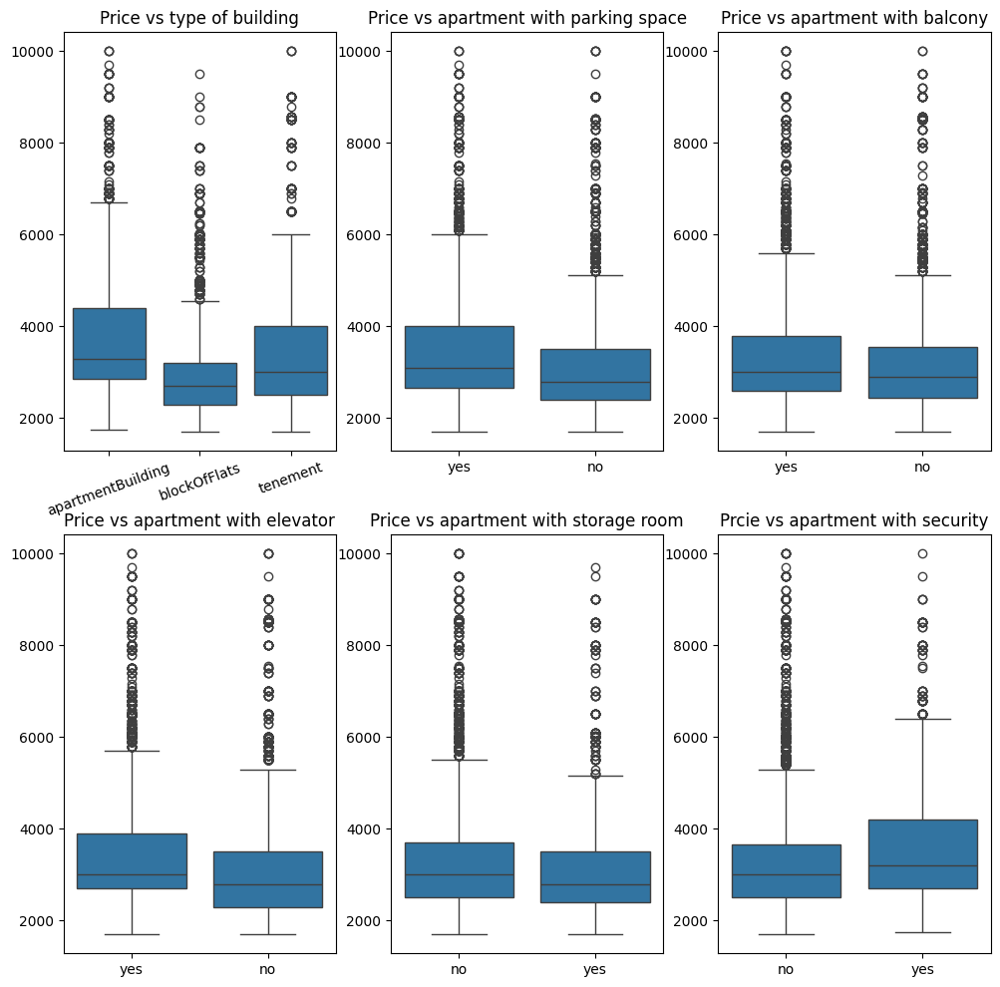

In [26]:
#checking whether there are differences in price based on additional features such as a parking spot, balcony, or elevator
plt.figure(figsize=(12, 12))

plt.subplot(2, 3, 1)
g=sns.boxplot(y='price', x='type',data=df)
plt.title('Price vs type of building')
plt.xticks(rotation=20)
g.set(xlabel=None,ylabel=None)

plt.subplot(2, 3, 2)
g=sns.boxplot(y='price', x='hasParkingSpace',data=df)
plt.title('Price vs apartment with parking space')
g.set(xlabel=None,ylabel=None)

plt.subplot(2, 3, 3)
g=sns.boxplot(y='price', x='hasBalcony',data=df)
plt.title('Price vs apartment with balcony')
g.set(xlabel=None,ylabel=None)

plt.subplot(2, 3, 4)
g=sns.boxplot(y='price', x='hasElevator',data=df)
plt.title('Price vs apartment with elevator')
g.set(xlabel=None,ylabel=None)

plt.subplot(2, 3, 5)
g=sns.boxplot(y='price', x='hasStorageRoom',data=df)
plt.title('Price vs apartment with storage room')
g.set(xlabel=None,ylabel=None)

plt.subplot(2, 3, 6)
g=sns.boxplot(y='price', x='hasSecurity',data=df)
plt.title('Prcie vs apartment with security')
g.set(xlabel=None,ylabel=None)

plt.show()

The dataset includes three types of residential buildings where apartments are located:

Tenement: Historic, multi-story urban buildings, common in Poland from medieval to early modern times.

Block of Flats: Large residential buildings, often built with concrete or prefabricated slabs (especially from the 1960s–1980s), typically more basic in construction.

Apartment Building: Modern, higher-standard buildings aimed at the premium market, often featuring amenities like secure parking, rooftop terraces, or fitness centers.

As we can see, the year of construction affects the price. The most expensive are newly built apartment buildings (modern housing), followed by block of flats from the second half of the 20th century, and finally historic buildings, which tend to be the least expensive.

Other features, such as security or a balcony, seem to slightly affect the price.


# Chapter 2: Anomalies in room count based on apartment size


I use a boxplot to look at how apartment sizes (in square meters) vary depending on the number of rooms. This helps spot anything unusual—like really small apartments with lots of rooms, or very large places with just one room. It's a quick way to check if the data makes sense or if there are any outliers worth looking into.

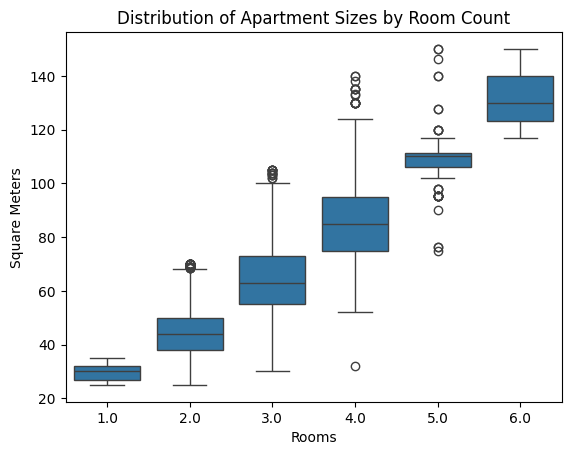

In [27]:
#visualizing the distribution of apartment size (in square meters) by number of rooms – to check for any anomalies, like very small apartments with many rooms, or the opposite.
sns.boxplot(x='rooms', y='squareMeters', data=df)
plt.title('Distribution of Apartment Sizes by Room Count')
plt.xlabel('Rooms')
plt.ylabel('Square Meters')
plt.show()

General guidelines suggest comfortable room sizes as follows: bedrooms 10–15 m², living rooms 15–25 m², kitchens 8–12 m², bathrooms 4–6 m², and home offices or small rooms at least 6–8 m².

Therefore if an apartment has multiple rooms, a healthy average room size would typically be around 18–25 m², depending on the layout and function of each room.

I created a new feature to measure the average room size in each apartment. On average, rooms are around 23 m², which is within a healthy living range based on common architectural guidelines. Most apartments fall into a comfortable size range (IQR: 19.19 - 26), although there is one outlier with only 8 m² per room, which may be a data issue or an unusually small layout - we can see it on scatter plot. It’s also important to remember that this metric doesn’t show how space is actually divided between rooms—it only gives an average.

In [28]:
#calculating average size of a room in each apartment - this helps to understand how spacious the rooms are in different apartments
df['squarePerRoom'] = df['squareMeters']/df['rooms']

#statistics for square per room
print(df['squarePerRoom'].describe())

count    12661.000000
mean        22.932803
std          4.700799
min          8.000000
25%         19.193333
50%         22.333333
75%         26.000000
max         35.000000
Name: squarePerRoom, dtype: float64


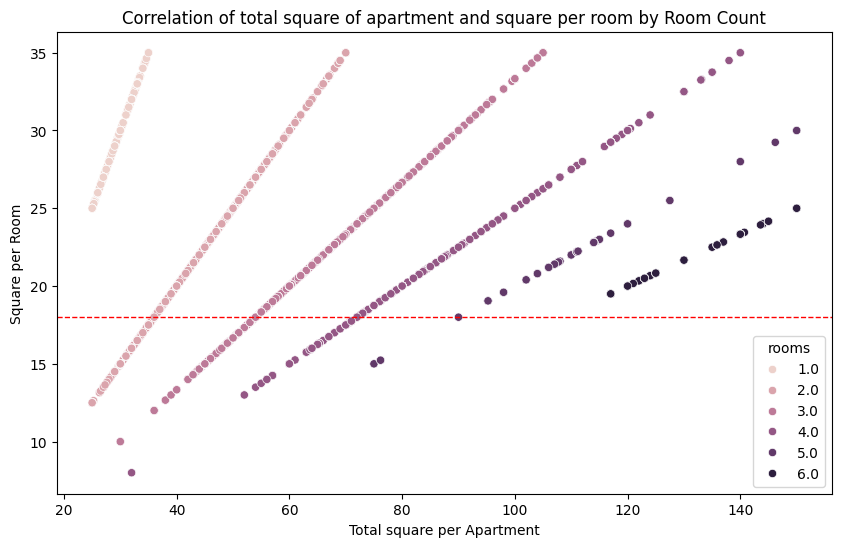

In [29]:
#visualizing corelation between total square and room square
plt.subplots(figsize=(10, 6))
sns.scatterplot(data=df, x='squareMeters',y='squarePerRoom', hue='rooms')
plt.axhline(y=18, color='red', linestyle='--', linewidth=1)
plt.title('Correlation of total square of apartment and square per room by Room Count')
plt.xlabel('Total square per Apartment')
plt.ylabel('Square per Room')
plt.show()

# Chapter 3: Influence of distance to the city center on apartment prices

This visualization explores the relationship between apartment price and distance to the city center. Typically, properties closer to the center tend to have higher prices, while those farther away are generally more affordable. The plot helps confirm if this trend holds true in our dataset.


The results do not fully support the theory that apartments closer to the center are more expensive. In my opinion, there are many factors influencing the correlation between price and distance to the center.
In the plot above, we can see that some 19th-century apartments are very inexpensive, even though they are located close to the center.
Moreover, factors such as total square footage and the number of rooms, which we discussed earlier, seem to have a greater impact on price than distance alone.
To examine this hypothesis more closely, it would be better to create a dataset of apartments with similar size, condition, year of construction, number of rooms, and so on.

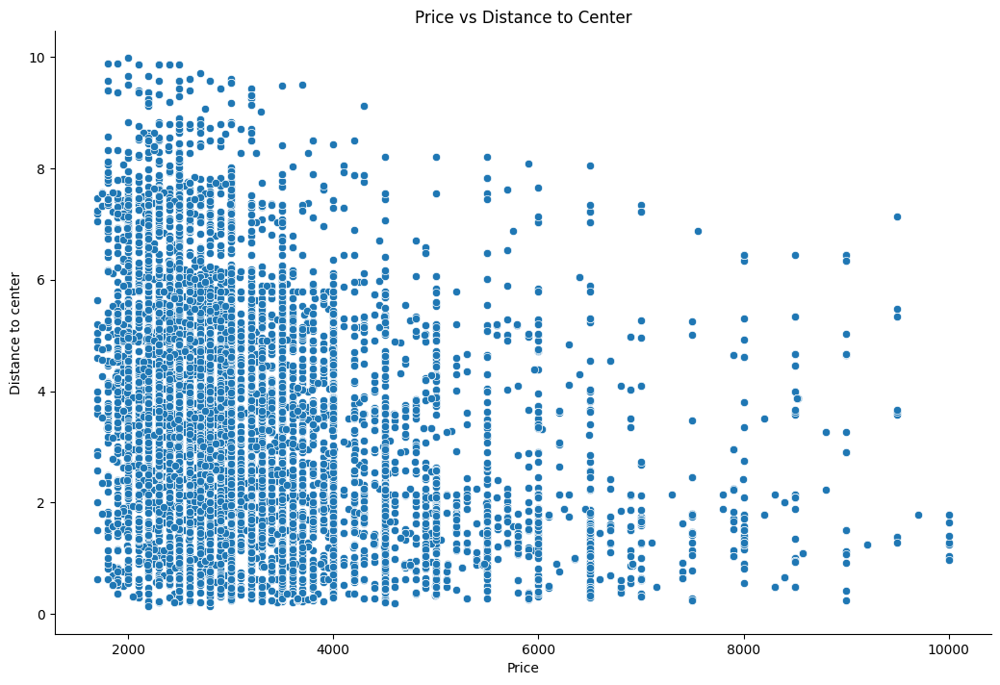

In [30]:
#visualizing the relationship between price and distance to the city center – I expect that apartments closer to the center will have higher prices compared to those farther away
sns.relplot(data=df, x='price',y='centreDistance',kind='scatter',height=7, aspect=1.5)
plt.title('Price vs Distance to Center')
plt.xlabel('Price')
plt.ylabel('Distance to center')
plt.show()

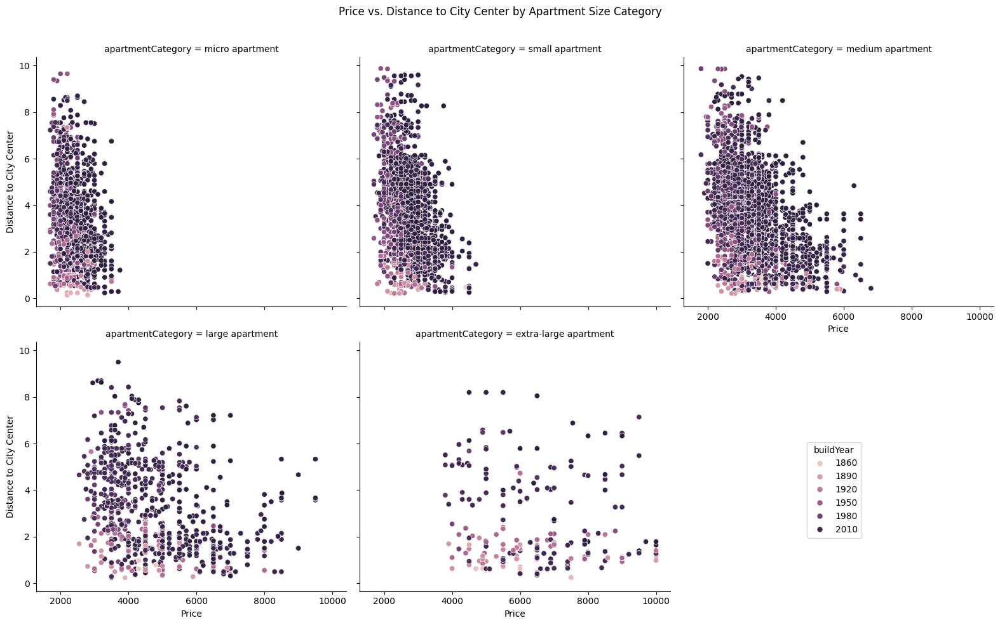

In [31]:
#distribution of price vs distance to center by apartment category
g=sns.relplot(x="price",y="centreDistance",data=df,kind="scatter",col="apartmentCategory",col_wrap=3,hue='buildYear')
g.fig.suptitle("Price vs. Distance to City Center by Apartment Size Category", fontsize=12)
sns.move_legend(g, "upper left", bbox_to_anchor=(.80, .30),frameon=True)
g.set_axis_labels("Price", "Distance to City Center")
g.fig.tight_layout()
g.fig.subplots_adjust(top=0.9)
plt.show()

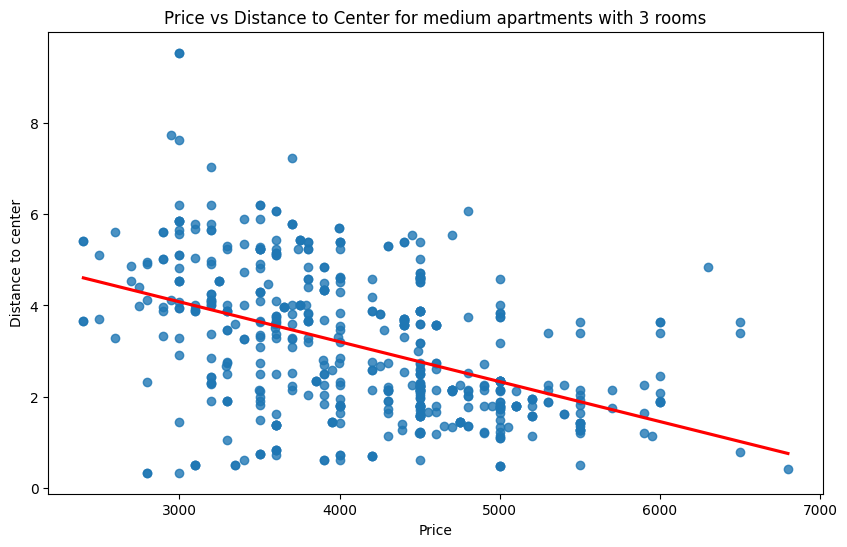

In [32]:
#closer look
df_med_apartment=df[(df['apartmentCategory']=='medium apartment') & (df['type']=='apartmentBuilding') & (df['rooms']==3) & (df['buildYear']>=2000)]
plt.figure(figsize=(10, 6))
sns.regplot(data=df_med_apartment, x='price',y='centreDistance',scatter=True, line_kws=dict(color="red"),ci=None)
plt.title('Price vs Distance to Center for medium apartments with 3 rooms')
plt.xlabel('Price')
plt.ylabel('Distance to center')
plt.show()

# Chapter 4: Conclusions

The goal of this analysis was to examine which factors influence rental apartment prices in Kraków. Additionally, I aimed to check for anomalies in the number of rooms relative to the total apartment size, and to investigate whether proximity to the city center affects pricing.

The analysis was based primarily on visualizations, including boxplots, scatterplots, and line charts, leading to the following conclusions:

1. The main factors influencing rental prices are the size of the apartment and the number of rooms. Rental prices remained relatively stable over the 8-month period analyzed. Extra features such as parking spaces, balconies, or elevators did not show a significant impact on price.

2. No major anomalies were found in the number of rooms relative to apartment size. The average room size aligns well with commonly accepted guidelines for comfortable living space.

3. There is a correlation between price and distance to the city center; however, the filters used for comparison should be refined to ensure that listings being compared have similar characteristics.